In [1]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

In [2]:
!pwd

/Users/zeynepcankara/GitHub-Projects/final-challenge-2-albertobeto/nbs


In [3]:
img = Image.open("../Data_Challenge2/train_just_masked/400_masked.jpg")
imgSize = img.size

mask = Image.open("../Data_Challenge2/train_just_mask/400_mask.jpg")
imgSize = mask.size

In [4]:
print(type(img))
print(type(mask))
img_np = np.array(img)

<class 'PIL.JpegImagePlugin.JpegImageFile'>
<class 'PIL.JpegImagePlugin.JpegImageFile'>


In [5]:
mask_new = np.dstack([np.array(mask), np.array(mask), np.array(mask)])
print(mask_new.shape)

(688, 692, 3)


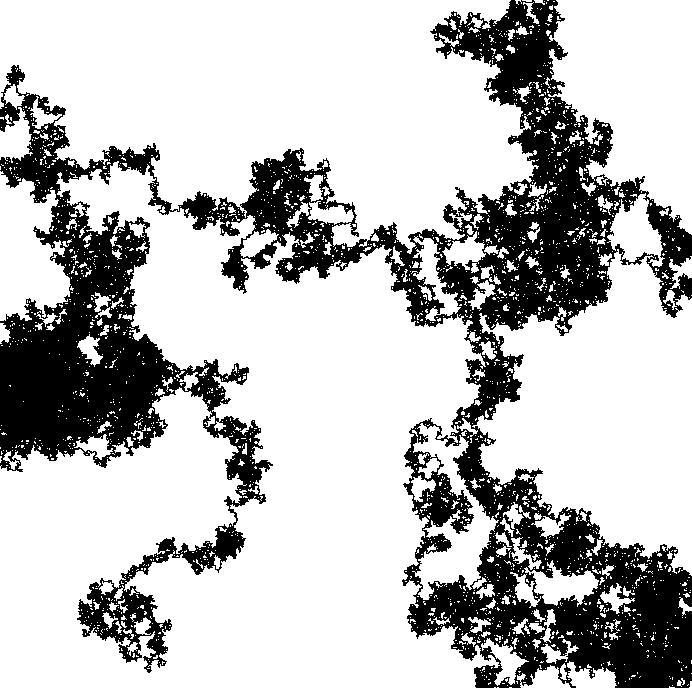

In [6]:
mask

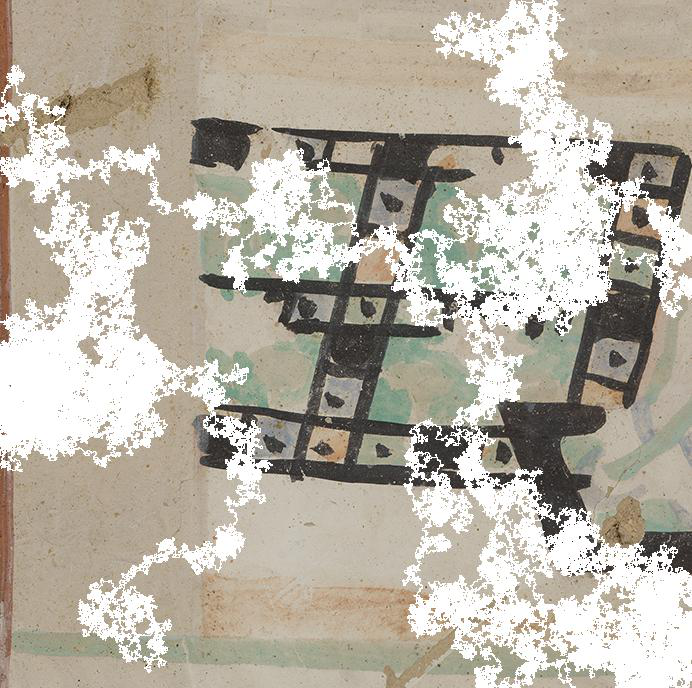

In [7]:
img

In [8]:
print(np.array(mask).shape)

print(np.array(img).shape)

(688, 692)
(688, 692, 3)


In [9]:
# create the function
def fill_mask(row, col, height, width, orig_img):
    """
    Fill the mask cell with the nearest neighbour pixel of image
    Params:
      col, type(int)
      row, type(int)
      height, type(int)
      width, type(int)
    """
    # select a value from neighbour 
    fill_val_1 = 255
    fill_val_2 = 255
    fill_val_3 = 255
    if row-1 >= 0:
        fill_val_1 = orig_img[row-1][col][0]
        fill_val_2 = orig_img[row-1][col][1]
        fill_val_3 = orig_img[row-1][col][2]
    elif row+1 < height:
        fill_val_1 = orig_img[row+1][col][0]
        fill_val_2 = orig_img[row+1][col][1]
        fill_val_3 = orig_img[row+1][col][2]
    elif col-1 >= 0:
        fill_val_1 = orig_img[row][col-1][0]
        fill_val_2 = orig_img[row][col-1][1]
        fill_val_3 = orig_img[row][col-1][2]   
    elif col+1 < width:
        fill_val_1 = orig_img[row][col+1][0]
        fill_val_2 = orig_img[row][col+1][1]
        fill_val_3 = orig_img[row][col+1][2]  
    else:
        pass

    return fill_val_1, fill_val_2, fill_val_3

In [35]:
def detect_gradient(row, col, height, width, mask, orig_img):
    """
    Detects the whether the cell needs to be imputation or not
    """
    #print("Pos: %s, %s"%(row, col))
    mark_cell = False
    fill_val_1, fill_val_2, fill_val_3 = 0, 0, 0
    try:
        if (row-1) >= 0 and np.abs(mask[row-1][col] -  mask[row][col]) >= 200:
            mark_cell = True
            mark_row = row-1
            mark_col = col
        elif (row+1) < height and np.abs(mask[row+1][col] - mask[row][col]) >= 200:
            mark_cell = True
            mark_row = row+1
            mark_col = col
        elif (col-1) >= 0 and np.abs(mask[row][col-1] -  mask[row][col]) >= 200:
            mark_cell = True
            mark_row = row
            mark_col = col-1
        elif (col+1) < width and np.abs(mask[row][col+1] -  mask[row][col]) >= 200:
            mark_cell = True
            mark_row = row
            mark_col = col+1
        else:
            pass
    except:
        # Couldnt figured that bug out
        print("row+1", row)
        print("height", height)

    if mark_cell:
        #print(orig_img[mark_row][mark_col][0])
        fill_val_1 = orig_img[mark_row][mark_col][0]
        fill_val_2 = orig_img[mark_row][mark_col][1]
        fill_val_3 = orig_img[mark_row][mark_col][2]

    return mark_cell, fill_val_1, fill_val_2, fill_val_3


In [36]:
def shrink_mask(img, mask):
    """
    Shrinks mask via nearest neighbour imputation
    Params:
      img, type(PIL.JpegImagePlugin.JpegImageFile): 
      mask, type(PIL.JpegImagePlugin.JpegImageFile):
    Returns: 
      mask_new, type(numpy array): Imputed mask
    """
    width = img.size[1]
    height = img.size[0]
    print(type(width))
    # 3D array
    img_np = np.array(img, dtype='int64')
    # 2D array
    mask_np = np.array(mask, dtype='int64')
    # construct the new mask from original mask
    mask_new = np.dstack([np.array(mask), np.array(mask), np.array(mask)])

    for r in range(height):
        for c in range(width):
            mark_cell, fill_val_1, fill_val_2, fill_val_3 = detect_gradient(r, c, height, width, mask_np, img_np)
            if mark_cell:
                mask_new[r][c][0] = fill_val_1
                mask_new[r][c][1] = fill_val_2
                mask_new[r][c][2] = fill_val_3

    return mask_new 


In [37]:
mask_new = shrink_mask(img, mask)

<class 'int'>
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692

height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
ro

height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
ro

height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
ro

row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
hei

row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
hei

row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
hei

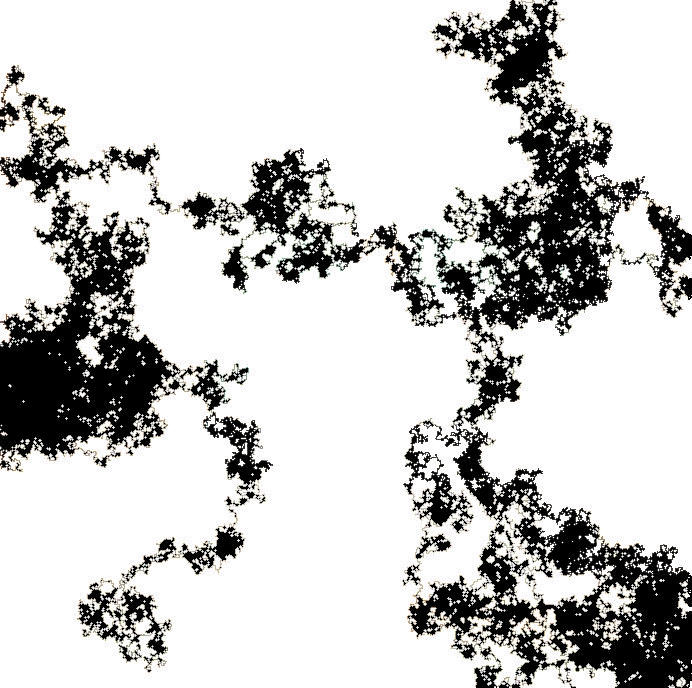

In [39]:
Image.fromarray(mask_new, 'RGB')

In [46]:
print(type(mask_new_rgb))

<class 'PIL.Image.Image'>


In [47]:
print(mask_new_rgb.size)

(692, 688)


In [42]:
mask_new_rgb = Image.fromarray(mask_new, 'RGB')

In [43]:
mask_new_2 = shrink_mask(img, mask_new_rgb)

<class 'int'>
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 692
row+1 0
height 69

row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
height 692
row+1 1
heig

height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
row+1 2
height 692
r

height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
row+1 3
height 692
r

row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
height 692
row+1 4
heig

row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
height 692
row+1 5
heig

row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
height 692
row+1 6
heig

height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
row+1 7
height 692
r

height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
row+1 8
height 692
r

row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
height 692
row+1 9
heig

row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692
row+1 10
height 692


row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692
row+1 11
height 692


height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12


height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12
height 692
row+1 12


row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692
row+1 13
height 692


height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14


row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692
row+1 14
height 692


height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16
height 692
row+1 16


height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17
height 692
row+1 17


row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692


row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692
row+1 18
height 692


row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692
row+1 19
height 692


height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20


row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692
row+1 20
height 692


height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21
height 692
row+1 21


height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22


height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22
height 692
row+1 22


row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692
row+1 23
height 692


height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24


height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24
height 692
row+1 24


row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692
row+1 25
height 692


height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26


row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692
row+1 26
height 692


row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692
row+1 27
height 692


row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692


height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28
height 692
row+1 28


height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29


row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 29
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692


height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30
height 692
row+1 30


row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692
row+1 31
height 692


height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33


height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33
height 692
row+1 33


height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34
height 692
row+1 34


row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692
row+1 35
height 692


row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692
row+1 36
height 692


row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692
row+1 37
height 692


height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38
height 692
row+1 38


height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39
height 692
row+1 39


height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40


row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692
row+1 40
height 692


row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692
row+1 41
height 692


row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692
row+1 42
height 692


height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43
height 692
row+1 43


height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44


height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44
height 692
row+1 44


row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692
row+1 45
height 692


row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692
row+1 46
height 692


row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692


row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692
row+1 47
height 692


height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48


row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 48
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692


height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49
height 692
row+1 49


row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692


height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50
height 692
row+1 50


row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 51
height 692
row+1 52
height 692


row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692
row+1 53
height 692


row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692
row+1 54
height 692


height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55
height 692
row+1 55


row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692


height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56
height 692
row+1 56


height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57
height 692
row+1 57


row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692
row+1 58
height 692


height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59
height 692
row+1 59


height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60


row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692
row+1 60
height 692


height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62


height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62
height 692
row+1 62


height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64
height 692
row+1 64


row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692


height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65
height 692
row+1 65


row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 66
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692


height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67
height 692
row+1 67


height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68
height 692
row+1 68


height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69
height 692
row+1 69


row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692


row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692
row+1 70
height 692


row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 71
height 692
row+1 72
height 692
row+1 72
height 692


height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72
height 692
row+1 72


height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73
height 692
row+1 73


height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74
height 692
row+1 74


row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692


row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692
row+1 75
height 692


row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692
row+1 76
height 692


row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692


height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77
height 692
row+1 77


row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692
row+1 78
height 692


height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79


row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692
row+1 79
height 692


height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 80
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81
height 692
row+1 81


row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692
row+1 82
height 692


row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692


row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 83
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692


row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692
row+1 84
height 692


row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692


row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692
row+1 85
height 692


row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692


row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692
row+1 87
height 692


height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88


height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88
height 692
row+1 88


height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89
height 692
row+1 89


row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692


row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692
row+1 90
height 692


row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692
row+1 91
height 692


height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92


row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692
row+1 92
height 692


height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93
height 692
row+1 93


row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692


height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94
height 692
row+1 94


row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692
row+1 95
height 692


row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692


row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692
row+1 96
height 692


row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692


height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 97
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98


height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98
height 692
row+1 98


height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99
height 692
row+1 99


height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
ro

row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
height 692
row+1 100
hei

row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
height 692
row+1 101
hei

row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
hei

row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
height 692
row+1 102
hei

row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
hei

row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 103
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
hei

row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
height 692
row+1 104
hei

height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
ro

height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 105
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
ro

row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
height 692
row+1 106
hei

height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
ro

row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 107
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
hei

height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
row+1 108
height 692
ro

row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
hei

height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 109
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
ro

row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
height 692
row+1 110
hei

height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
ro

row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
height 692
row+1 111
hei

row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
height 692
row+1 112
hei

row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
hei

row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 113
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
hei

height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
row+1 114
height 692
ro

height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
row+1 115
height 692
ro

height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
ro

row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
height 692
row+1 116
hei

row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
height 692
row+1 117
hei

row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
hei

row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 118
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
hei

height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
row+1 119
height 692
ro

height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
row+1 120
height 692
ro

height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
ro

height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
row+1 121
height 692
ro

row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
height 692
row+1 122
hei

row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
height 692
row+1 123
hei

row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
hei

row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
height 692
row+1 124
hei

height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
row+1 125
height 692
ro

height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
ro

height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 126
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
ro

height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
row+1 127
height 692
ro

row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
height 692
row+1 128
hei

row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
hei

row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
height 692
row+1 129
hei

row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
height 692
row+1 130
hei

row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
hei

row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
height 692
row+1 131
hei

height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
row+1 132
height 692
ro

height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
ro

row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
height 692
row+1 133
hei

row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
height 692
row+1 134
hei

height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
ro

row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
height 692
row+1 135
hei

row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
height 692
row+1 136
hei

height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
ro

height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
row+1 137
height 692
ro

height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
row+1 138
height 692
ro

height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
ro

row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
height 692
row+1 139
hei

row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
height 692
row+1 140
hei

height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
ro

height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
row+1 141
height 692
ro

row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
height 692
row+1 142
hei

row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
hei

row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
height 692
row+1 143
hei

row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
height 692
row+1 144
hei

row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
hei

row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
height 692
row+1 145
hei

height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
row+1 146
height 692
ro

height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
ro

row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
height 692
row+1 147
hei

height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
row+1 148
height 692
ro

height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
ro

row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
height 692
row+1 149
hei

height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
row+1 150
height 692
ro

row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
hei

height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
row+1 151
height 692
ro

height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
row+1 152
height 692
ro

row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
hei

row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
height 692
row+1 153
hei

row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
height 692
row+1 154
hei

height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
ro

row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
height 692
row+1 155
hei

row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
height 692
row+1 156
hei

height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
ro

row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
height 692
row+1 157
hei

row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
height 692
row+1 158
hei

row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
hei

row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
height 692
row+1 159
hei

row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
height 692
row+1 160
hei

height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
ro

height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
row+1 161
height 692
ro

row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
height 692
row+1 162
hei

height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
row+1 163
height 692
ro

height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
ro

height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
row+1 164
height 692
ro

height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
row+1 165
height 692
ro

row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
hei

row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
height 692
row+1 166
hei

row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
height 692
row+1 167
hei

row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
height 692
row+1 168
hei

height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
ro

height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
row+1 169
height 692
ro

height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
row+1 170
height 692
ro

height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
row+1 171
height 692
ro

row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
hei

row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
height 692
row+1 172
hei

row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
height 692
row+1 173
hei

row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
hei

height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
row+1 174
height 692
ro

height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
row+1 175
height 692
ro

height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
row+1 176
height 692
ro

height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
ro

row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
height 692
row+1 177
hei

row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
height 692
row+1 178
hei

row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
height 692
row+1 179
hei

row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
hei

row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
height 692
row+1 180
hei

row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
height 692
row+1 181
hei

height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
ro

height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
row+1 182
height 692
ro

row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
hei

height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 183
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
ro

row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
height 692
row+1 184
hei

height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
ro

row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 185
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
hei

row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
height 692
row+1 186
hei

height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
ro

row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 187
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
hei

row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
height 692
row+1 188
hei

row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
hei

row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 189
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
hei

height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
row+1 190
height 692
ro

height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
ro

height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 191
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
ro

row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
height 692
row+1 192
hei

row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
hei

row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
height 692
row+1 193
hei

row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
height 692
row+1 194
hei

height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
ro

row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
height 692
row+1 195
hei

height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
row+1 196
height 692
ro

row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
hei

height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
row+1 197
height 692
ro

row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
height 692
row+1 198
hei

row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
hei

height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
row+1 199
height 692
ro

height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
row+1 200
height 692
ro

row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
hei

row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
height 692
row+1 201
hei

row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
height 692
row+1 202
hei

row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
hei

row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
height 692
row+1 203
hei

height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
row+1 204
height 692
ro

height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
row+1 205
height 692
ro

row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
height 692
row+1 206
hei

height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
ro

row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
height 692
row+1 207
hei

height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
row+1 208
height 692
ro

height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
ro

row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
height 692
row+1 209
hei

row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
height 692
row+1 210
hei

height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
ro

height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
row+1 211
height 692
ro

row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
height 692
row+1 212
hei

height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
ro

height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
row+1 213
height 692
ro

row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
height 692
row+1 214
hei

row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
hei

row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
height 692
row+1 215
hei

row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
height 692
row+1 216
hei

height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
row+1 217
height 692
ro

height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
row+1 218
height 692
ro

height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
ro

height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 219
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
ro

row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
height 692
row+1 220
hei

row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
height 692
row+1 221
hei

row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
hei

row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
height 692
row+1 222
hei

height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
row+1 223
height 692
ro

height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
row+1 224
height 692
ro

height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
ro

height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
row+1 225
height 692
ro

row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
height 692
row+1 226
hei

height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
row+1 227
height 692
ro

height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
row+1 228
height 692
ro

height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
row+1 229
height 692
ro

row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
hei

height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
row+1 230
height 692
ro

row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
height 692
row+1 231
hei

row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
height 692
row+1 232
hei

height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
ro

height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 233
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
ro

height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
row+1 234
height 692
ro

height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
row+1 235
height 692
ro

row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
hei

row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 236
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
hei

row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
height 692
row+1 237
hei

height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
row+1 238
height 692
ro

height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
ro

row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 239
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
hei

height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
row+1 240
height 692
ro

height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
ro

row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
height 692
row+1 241
hei

row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
height 692
row+1 242
hei

height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
row+1 243
height 692
ro

row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
height 692
row+1 244
hei

row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
height 692
row+1 245
hei

height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 246
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
ro

row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
height 692
row+1 247
hei

height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
row+1 248
height 692
ro

row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
height 692
row+1 249
hei

height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
row+1 250
height 692
ro

row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
height 692
row+1 251
hei

height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
ro

height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
row+1 253
height 692
ro

height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
row+1 254
height 692
ro

row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
height 692
row+1 255
hei

row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
hei

row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
height 692
row+1 256
hei

row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
height 692
row+1 257
hei

height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
row+1 258
height 692
ro

height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
ro

row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
height 692
row+1 259
hei

row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
hei

row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
height 692
row+1 261
hei

height 692
row+1 262
height 692
row+1 262
height 692
row+1 262
height 692
row+1 262
height 692
row+1 262
height 692
row+1 262
height 692
row+1 262
height 692
row+1 262
height 692
row+1 262
height 692
row+1 262
height 692
row+1 262
height 692
row+1 262
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
row+1 263
height 692
ro

height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
row+1 264
height 692
ro

row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
height 692
row+1 265
hei

height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
row+1 266
height 692
ro

row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
hei

row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
height 692
row+1 267
hei

height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
ro

row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 268
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
hei

height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
row+1 269
height 692
ro

height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
ro

row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
height 692
row+1 270
hei

height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
row+1 271
height 692
ro

row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
hei

row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
height 692
row+1 272
hei

height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 273
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
ro

height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
row+1 274
height 692
ro

height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
row+1 275
height 692
ro

row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
height 692
row+1 276
hei

row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
height 692
row+1 277
hei

row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
hei

height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
row+1 278
height 692
ro

height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
ro

row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
height 692
row+1 280
hei

row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
height 692
row+1 281
hei

row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 282
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
hei

height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
row+1 283
height 692
ro

height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
ro

height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 284
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
row+1 285
height 692
ro

row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
hei

row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
height 692
row+1 286
hei

row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
height 692
row+1 287
hei

row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
hei

height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
row+1 288
height 692
ro

height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
row+1 289
height 692
ro

height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
ro

row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 290
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
hei

row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
height 692
row+1 291
hei

row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
height 692
row+1 292
hei

row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
hei

row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
height 692
row+1 293
hei

height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
row+1 294
height 692
ro

row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
height 692
row+1 295
hei

height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
row+1 296
height 692
ro

row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
height 692
row+1 297
hei

row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
hei

row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
height 692
row+1 298
hei

height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
ro

row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
height 692
row+1 300
hei

row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
hei

row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
height 692
row+1 301
hei

row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
height 692
row+1 302
hei

row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
height 692
row+1 303
hei

height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
row+1 304
height 692
ro

row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
hei

height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
row+1 305
height 692
ro

height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
row+1 306
height 692
ro

row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
hei

height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
row+1 307
height 692
ro

row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
hei

row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
height 692
row+1 308
hei

row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
height 692
row+1 309
hei

row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
height 692
row+1 310
hei

row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
hei

height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
row+1 311
height 692
ro

row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
height 692
row+1 313
hei

row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
hei

height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
row+1 314
height 692
ro

height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
ro

height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 315
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
row+1 316
height 692
ro

row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
height 692
row+1 317
hei

height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
row+1 318
height 692
ro

row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
height 692
row+1 319
hei

row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
height 692
row+1 320
hei

row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
height 692
row+1 321
hei

row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
hei

height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
row+1 322
height 692
ro

height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
row+1 323
height 692
ro

row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
height 692
row+1 324
hei

row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
height 692
row+1 325
hei

row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
hei

row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 326
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
hei

height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
row+1 327
height 692
ro

height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
row+1 328
height 692
ro

height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
row+1 329
height 692
ro

height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
ro

row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
height 692
row+1 330
hei

height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
row+1 331
height 692
ro

row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
height 692
row+1 332
hei

row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
height 692
row+1 333
hei

height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
ro

height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 334
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
ro

row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
height 692
row+1 335
hei

row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
hei

row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
height 692
row+1 336
hei

height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
row+1 337
height 692
ro

height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
ro

row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
height 692
row+1 338
hei

height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
row+1 339
height 692
ro

height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
ro

height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
row+1 340
height 692
ro

height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
ro

row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
height 692
row+1 342
hei

height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
ro

height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
row+1 343
height 692
ro

height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
row+1 344
height 692
ro

row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
height 692
row+1 345
hei

row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
hei

row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 346
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
hei

row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
height 692
row+1 347
hei

row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
height 692
row+1 348
hei

height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
ro

row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
height 692
row+1 349
hei

row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
hei

row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
height 692
row+1 350
hei

row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
height 692
row+1 351
hei

height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
ro

height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
row+1 352
height 692
ro

height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
row+1 353
height 692
ro

row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
height 692
row+1 354
hei

row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
height 692
row+1 355
hei

row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
hei

row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
height 692
row+1 356
hei

height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
ro

height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 357
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
ro

height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
row+1 358
height 692
ro

row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
hei

height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
row+1 359
height 692
ro

height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
row+1 360
height 692
ro

height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
ro

row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
height 692
row+1 361
hei

row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
height 692
row+1 362
hei

height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
row+1 363
height 692
ro

row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
hei

height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
row+1 364
height 692
ro

row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
height 692
row+1 365
hei

row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
height 692
row+1 366
hei

row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
hei

row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
height 692
row+1 367
hei

height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
row+1 368
height 692
ro

height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
ro

height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
row+1 369
height 692
ro

height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
row+1 370
height 692
ro

row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
hei

height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
row+1 371
height 692
ro

row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
height 692
row+1 372
hei

height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
ro

height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
row+1 373
height 692
ro

height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
ro

row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
height 692
row+1 374
hei

row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
height 692
row+1 375
hei

row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
height 692
row+1 376
hei

row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
height 692
row+1 377
hei

height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
row+1 378
height 692
ro

row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
height 692
row+1 379
hei

row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
height 692
row+1 380
hei

row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
hei

row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 381
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
hei

row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
height 692
row+1 382
hei

height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
row+1 383
height 692
ro

height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
ro

height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
row+1 384
height 692
ro

height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
row+1 385
height 692
ro

row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
height 692
row+1 386
hei

row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
height 692
row+1 387
hei

row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
height 692
row+1 388
hei

height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
row+1 389
height 692
ro

row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
height 692
row+1 390
hei

row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
height 692
row+1 391
hei

row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
height 692
row+1 392
hei

row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
hei

height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
row+1 393
height 692
ro

height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
ro

height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
row+1 394
height 692
ro

row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
hei

row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
height 692
row+1 396
hei

height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
ro

row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 397
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
hei

row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
height 692
row+1 398
hei

row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
height 692
row+1 399
hei

height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
ro

height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 400
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
ro

height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
row+1 401
height 692
ro

height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
ro

row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
height 692
row+1 402
hei

height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
row+1 403
height 692
ro

height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
ro

row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
height 692
row+1 404
hei

height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
ro

row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 405
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
height 692
row+1 406
hei

row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
height 692
row+1 407
hei

row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
height 692
row+1 408
hei

height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
ro

height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 409
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
ro

height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
row+1 410
height 692
ro

height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
row+1 411
height 692
ro

row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
hei

row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
height 692
row+1 412
hei

row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
height 692
row+1 413
hei

row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
height 692
row+1 414
hei

height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
ro

height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
row+1 415
height 692
ro

height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
row+1 416
height 692
ro

row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
hei

row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
height 692
row+1 417
hei

row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
height 692
row+1 418
hei

row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
height 692
row+1 419
hei

height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
row+1 420
height 692
ro

row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
height 692
row+1 421
hei

row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
height 692
row+1 422
hei

row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
hei

row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
height 692
row+1 423
hei

row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
hei

row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
height 692
row+1 424
hei

row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
height 692
row+1 425
hei

height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
ro

row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
height 692
row+1 426
hei

height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
row+1 427
height 692
ro

row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
hei

height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
row+1 428
height 692
ro

row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
hei

row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
height 692
row+1 429
hei

row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
height 692
row+1 430
hei

row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
hei

height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
row+1 431
height 692
ro

row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
height 692
row+1 432
hei

row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
hei

height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
row+1 433
height 692
ro

row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
hei

height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 434
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
ro

row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
height 692
row+1 435
hei

height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
ro

height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
row+1 436
height 692
ro

row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
height 692
row+1 437
hei

height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
row+1 438
height 692
ro

row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
height 692
row+1 439
hei

height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
row+1 440
height 692
ro

row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
height 692
row+1 441
hei

row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
height 692
row+1 442
hei

row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
hei

row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
height 692
row+1 443
hei

row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
height 692
row+1 444
hei

height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
ro

height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
row+1 445
height 692
ro

height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
row+1 446
height 692
ro

row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
hei

row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
height 692
row+1 447
hei

row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
height 692
row+1 448
hei

row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
height 692
row+1 449
hei

height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
ro

height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
row+1 450
height 692
ro

height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
ro

height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
row+1 451
height 692
ro

height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
row+1 452
height 692
ro

height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
row+1 453
height 692
ro

height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
row+1 454
height 692
ro

height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
row+1 455
height 692
ro

height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
row+1 456
height 692
ro

height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
row+1 457
height 692
ro

row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
height 692
row+1 458
hei

height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
row+1 459
height 692
ro

row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
hei

height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 460
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
ro

row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 461
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
hei

height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
row+1 462
height 692
ro

row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
hei

row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
height 692
row+1 463
hei

row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
height 692
row+1 464
hei

row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
height 692
row+1 465
hei

row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
height 692
row+1 466
hei

height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
row+1 467
height 692
ro

height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
ro

row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
height 692
row+1 468
hei

row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
height 692
row+1 469
hei

height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
ro

height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
row+1 471
height 692
ro

height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
row+1 472
height 692
ro

row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
height 692
row+1 473
hei

row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
height 692
row+1 474
hei

height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
row+1 475
height 692
ro

row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
height 692
row+1 476
hei

row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
height 692
row+1 477
hei

height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
row+1 478
height 692
ro

height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
row+1 479
height 692
ro

height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
ro

height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
row+1 480
height 692
ro

row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
height 692
row+1 481
hei

row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
height 692
row+1 482
hei

height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
row+1 483
height 692
ro

row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 484
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
height 692
row+1 485
hei

row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
height 692
row+1 486
hei

height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
ro

row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
height 692
row+1 487
hei

height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
ro

row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
height 692
row+1 489
hei

height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
row+1 490
height 692
ro

row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
hei

row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
height 692
row+1 491
hei

height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
ro

row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 492
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
hei

height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
row+1 493
height 692
ro

row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
height 692
row+1 494
hei

height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
row+1 495
height 692
ro

height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
ro

height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
row+1 496
height 692
ro

row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
hei

height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
row+1 497
height 692
ro

row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
height 692
row+1 498
hei

row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
height 692
row+1 499
hei

row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
height 692
row+1 500
hei

row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
height 692
row+1 501
hei

height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
row+1 502
height 692
ro

row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
height 692
row+1 503
hei

row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
height 692
row+1 504
hei

height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
row+1 505
height 692
ro

row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
height 692
row+1 506
hei

height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
row+1 507
height 692
ro

row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
height 692
row+1 508
hei

row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
hei

row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
height 692
row+1 509
hei

height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
row+1 510
height 692
ro

height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
row+1 511
height 692
ro

height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
ro

row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 512
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
height 692
row+1 513
hei

height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
row+1 514
height 692
ro

row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
hei

row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
height 692
row+1 515
hei

height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
row+1 516
height 692
ro

height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
row+1 517
height 692
ro

height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
ro

height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
row+1 518
height 692
ro

height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
ro

row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
height 692
row+1 519
hei

row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
height 692
row+1 520
hei

height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
row+1 521
height 692
ro

height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
row+1 522
height 692
ro

height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
ro

height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 523
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
ro

row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
height 692
row+1 524
hei

row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
hei

height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
row+1 525
height 692
ro

row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
height 692
row+1 526
hei

height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
ro

height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
row+1 527
height 692
ro

height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
row+1 528
height 692
ro

row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
hei

row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
height 692
row+1 529
hei

height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
row+1 530
height 692
ro

height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
ro

row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
height 692
row+1 531
hei

row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
height 692
row+1 532
hei

height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
ro

row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
height 692
row+1 533
hei

row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
hei

row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 534
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
hei

row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
height 692
row+1 535
hei

row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
hei

row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 536
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
hei

row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
height 692
row+1 537
hei

row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
height 692
row+1 538
hei

row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
hei

row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
height 692
row+1 540
hei

height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
row+1 541
height 692
ro

height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
ro

row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
height 692
row+1 542
hei

row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
height 692
row+1 543
hei

row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
height 692
row+1 544
hei

row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
hei

row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
height 692
row+1 545
hei

height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
row+1 546
height 692
ro

height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
ro

height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 547
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
ro

height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
row+1 548
height 692
ro

row+1 549
height 692
row+1 549
height 692
row+1 549
height 692
row+1 549
height 692
row+1 549
height 692
row+1 549
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
hei

row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
height 692
row+1 550
hei

row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
hei

height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
row+1 551
height 692
ro

height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
row+1 552
height 692
ro

height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
row+1 553
height 692
ro

height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
ro

height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 555
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
ro

height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 556
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
ro

height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
row+1 557
height 692
ro

row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
height 692
row+1 558
hei

height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
row+1 559
height 692
ro

height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
row+1 560
height 692
ro

height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
row+1 561
height 692
ro

row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
height 692
row+1 562
hei

row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
hei

row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
height 692
row+1 563
hei

row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 564
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
hei

row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
height 692
row+1 565
hei

height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
row+1 566
height 692
ro

height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
ro

row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 567
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
height 692
row+1 568
hei

height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
row+1 569
height 692
ro

height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
ro

height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
row+1 570
height 692
ro

row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
hei

row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 571
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
hei

height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
row+1 572
height 692
ro

row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
hei

row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 573
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
hei

height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
row+1 574
height 692
ro

row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
height 692
row+1 575
hei

row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
height 692
row+1 576
hei

row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
hei

height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
row+1 577
height 692
ro

row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
height 692
row+1 578
hei

row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
height 692
row+1 579
hei

height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
ro

height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
row+1 580
height 692
ro

row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
hei

row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 581
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
hei

height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
row+1 582
height 692
ro

height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
ro

height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
row+1 583
height 692
ro

row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
hei

row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 584
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
hei

height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
row+1 585
height 692
ro

row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
hei

row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
height 692
row+1 586
hei

height 692
row+1 587
height 692
row+1 587
height 692
row+1 587
height 692
row+1 587
height 692
row+1 587
height 692
row+1 587
height 692
row+1 587
height 692
row+1 587
height 692
row+1 587
height 692
row+1 587
height 692
row+1 587
height 692
row+1 587
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
ro

row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
height 692
row+1 588
hei

height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
ro

row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
height 692
row+1 589
hei

row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
height 692
row+1 590
hei

row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
height 692
row+1 591
hei

row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
hei

row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
height 692
row+1 592
hei

height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
row+1 593
height 692
ro

row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
hei

height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
row+1 595
height 692
ro

height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
row+1 596
height 692
ro

height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
row+1 597
height 692
ro

height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
row+1 598
height 692
ro

height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
row+1 599
height 692
ro

row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
height 692
row+1 600
hei

row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
hei

height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
row+1 601
height 692
ro

row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
hei

height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
row+1 602
height 692
ro

height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
row+1 603
height 692
ro

height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
row+1 604
height 692
ro

row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
height 692
row+1 605
hei

height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
row+1 606
height 692
ro

height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
row+1 607
height 692
ro

height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
ro

height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
row+1 608
height 692
ro

row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
height 692
row+1 609
hei

row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
hei

row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
height 692
row+1 610
hei

row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
height 692
row+1 611
hei

row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
hei

height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
row+1 612
height 692
ro

row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
hei

height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
row+1 613
height 692
ro

height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
row+1 614
height 692
ro

row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
hei

row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
height 692
row+1 615
hei

row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
height 692
row+1 616
hei

height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
ro

height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
row+1 617
height 692
ro

row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
height 692
row+1 618
hei

height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
row+1 619
height 692
ro

height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
ro

row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
height 692
row+1 620
hei

height 692
row+1 621
height 692
row+1 621
height 692
row+1 621
height 692
row+1 621
height 692
row+1 621
height 692
row+1 621
height 692
row+1 621
height 692
row+1 621
height 692
row+1 621
height 692
row+1 621
height 692
row+1 621
height 692
row+1 621
height 692
row+1 621
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
ro

row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
height 692
row+1 622
hei

height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
ro

height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
row+1 623
height 692
ro

height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
row+1 624
height 692
ro

row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
hei

height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
row+1 625
height 692
ro

height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
row+1 626
height 692
ro

row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
height 692
row+1 627
hei

row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
hei

height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
row+1 628
height 692
ro

height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
ro

row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
height 692
row+1 629
hei

height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
row+1 630
height 692
ro

row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
height 692
row+1 632
hei

height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
row+1 633
height 692
ro

row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
height 692
row+1 634
hei

height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
row+1 635
height 692
ro

height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
ro

height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
row+1 636
height 692
ro

row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
height 692
row+1 637
hei

height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
row+1 638
height 692
ro

row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
hei

row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
height 692
row+1 639
hei

row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
height 692
row+1 640
hei

row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
height 692
row+1 641
hei

height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
ro

height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 642
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
row+1 643
height 692
ro

height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
row+1 644
height 692
ro

row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
hei

row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
height 692
row+1 645
hei

height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
row+1 646
height 692
ro

row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
height 692
row+1 647
hei

row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
height 692
row+1 648
hei

row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
height 692
row+1 649
hei

height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
row+1 650
height 692
ro

row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
height 692
row+1 651
hei

row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
height 692
row+1 652
hei

row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 653
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
height 692
row+1 654
hei

height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
ro

height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
row+1 655
height 692
ro

row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
hei

height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
row+1 656
height 692
ro

row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
hei

height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 657
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
ro

row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
height 692
row+1 658
hei

row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
hei

height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
row+1 659
height 692
ro

row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
height 692
row+1 660
hei

row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
hei

row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
height 692
row+1 661
hei

row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
height 692
row+1 662
hei

height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
row+1 664
height 692
ro

row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
hei

height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
row+1 665
height 692
ro

row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 666
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
height 692
row+1 667
hei

row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
hei

height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
row+1 668
height 692
ro

height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
ro

row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 669
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
hei

height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
row+1 670
height 692
ro

row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
height 692
row+1 671
hei

height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
row+1 672
height 692
ro

row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
hei

row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
height 692
row+1 673
hei

height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
row+1 674
height 692
ro

height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
ro

height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
row+1 675
height 692
ro

height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
row+1 676
height 692
ro

height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
row+1 677
height 692
ro

height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
row+1 678
height 692
ro

height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
ro

row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
height 692
row+1 679
hei

row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
height 692
row+1 680
hei

height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
row+1 681
height 692
ro

row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
hei

row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
height 692
row+1 682
hei

height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
ro

height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
row+1 683
height 692
ro

height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
row+1 684
height 692
ro

height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
ro

row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
height 692
row+1 685
hei

row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
hei

row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
height 692
row+1 686
hei

height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 687
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
ro

height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
row+1 688
height 692
ro

height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
ro

height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
row+1 689
height 692
ro

row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
height 692
row+1 690
hei

row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
height 692
row+1 691
hei

#### Bug causes wrong mask shrinking


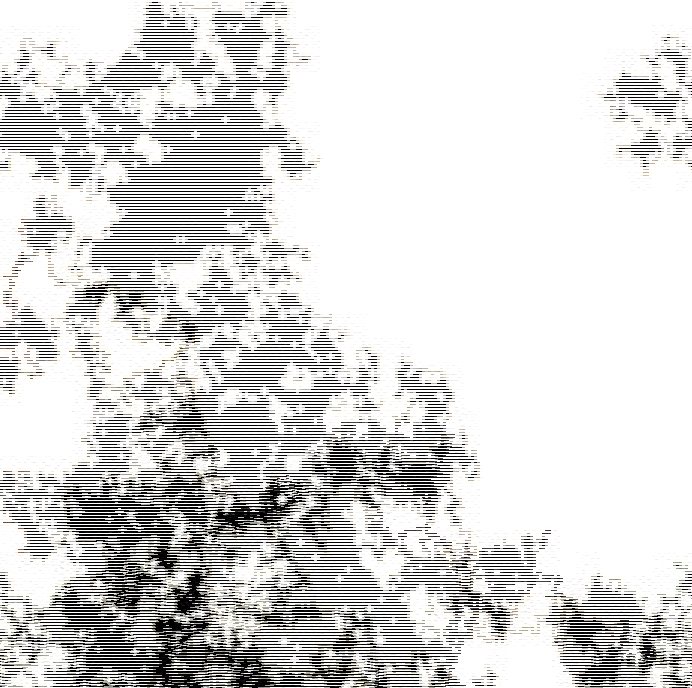

In [45]:
Image.fromarray(mask_new_2, 'RGB')